<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# Capstone: Detecting Manufacturing Nonconformities through Live Video Deep Learning Classification<br>

**Note**<br>
This code was run on a personal computer with the following specifications:<br>

CPU: AMD Ryzen 9 3950X 16-Core Processor 3.49 GHz<br>
RAM: 64 GB Crucial 3200MHz CL16<br>
GPU: NVIDIA RTX3080Ti<br>
Storage: ADATA SX8200 1TB NVME Gen 3<br>

The following was installed to run the code:

cudatoolkit               11.2.2<br>
cudnn                     8.1.0.77<br>
keras                     2.6.0<br>
keras-applications        1.0.8<br>
keras-preprocessing       1.1.2<br>
matplotlib                3.5.1<br>
numpy                     1.19.5<br>
opencv                    4.5.5<br>
pillow                    9.0.1<br>
python                    3.8.12<br>
seaborn                   0.11.2<br>
scikit-learn              1.0.2<br>
tensorflow                2.6.3<br>
tensorflow-gpu            2.6.3<br>
tensorflow-hub            0.12.0<br>
tflearn                   0.5.0<br>

# Contents:
- [Background](#Background)
- [Project Overview](#Project-Overview)
- [Model Development](#Model-Development)
- [Production Model Implementation](#Production-Model-Implementation)
- [Conclusion](#Conclusion)

# Background


#### Problem Statement

To implement a Live Video Deep Learning Classification Model to effectively detect product defects and procedural non-conformities in the Manufacturing Production Line.

#### Target Audience

Quality Control stakeholders in the Manufacturing sector.

#### Preamble

As a Manufacturing Quality Data Scientist, I, together with a task force, was tasked to investigate a Customer return merchandise authorization (RMA) event relating to a defect in one of our newly released products. Upon investigation, we found that there was a random periodical procedure non-conformance which was undetected and led to the Customer receiving the poor-quality product.

In the interim while the Manufacturing Process Engineer devise a more permanent solution, I was tasked to produce a Computer Vision Deep Learning solution that is effective in screening out non-conforming products and deviations specific to the investigated root cause to prevent further Quality escapes. 


# Project Overview


## Root Cause Investigation

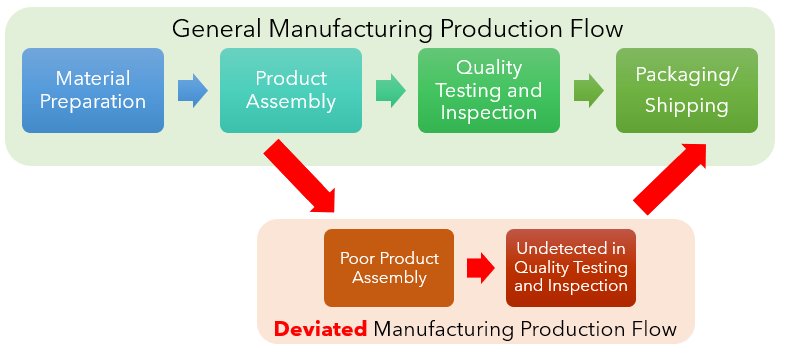

The above illustration depicts the simplified general manufacturing production flow. Specific to the above problem statement, after investigations, the deviation occured during `Product Assembly`, which was undetected in the subsequent process steps and especially during `Quality Testing and Inspection` portion of the Manufacturing Production Flow.

The deviation occurred due to a human error when installing yellow corner block components for the 4 printed circuit boards (PCBs) (in Green) under `Passing Product` below. This is depicted by the wrong installation of a red block components instead, as per `Failing Product` below.



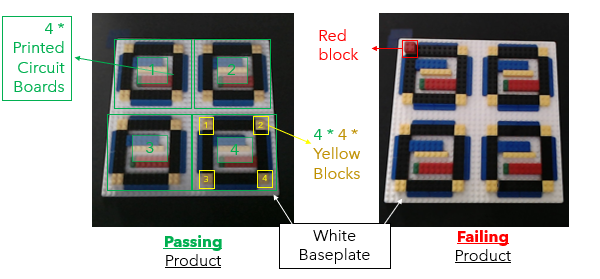

Note: Lego® blocks were used in this project to mimic component mounting on PCBs during electronics assembly.

## Deep Learning Solution Proposal

### Project Deliverables

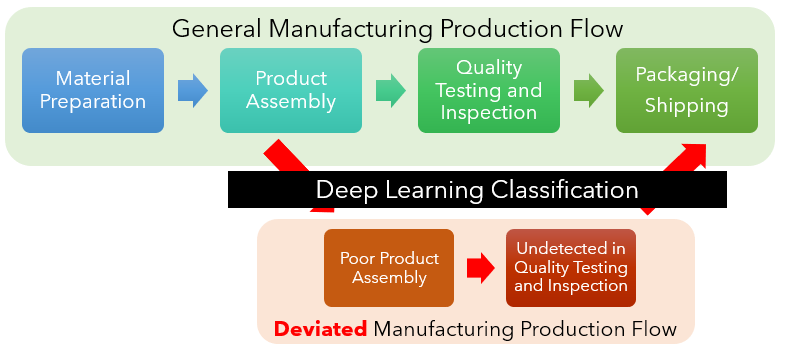

I was tasked to develop a Deep Learning Classification Model that is effective in screening out the aforementioned defect during the product assembly process. With this, the aim is to introduce an effective and reliable stop-gap measure to prevent the leakage of poor quality products to our Customers. A Convulational Neural Network (CNN) model will be used to develop this Deep Learning Classification Model.

### Setup Required

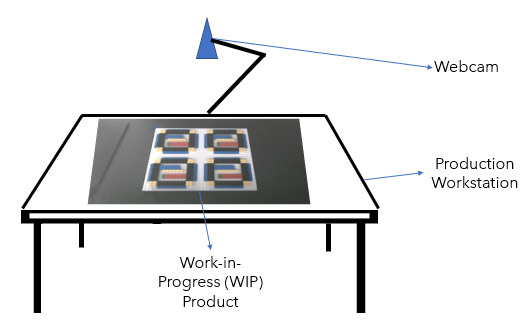

The expected outlay of capital required is only the procurement of a webcam and the labour + tools required to mount it on top with a bird's eye view of the workstation.

### Comparing Proposals for Model Implementation

It is important to determine the end-product for this project prior to model development as it affects the model development workflow. Two proposals were put forth with the Pros and Cons listed under each:

**<u>Image Classification**

Requires user-input to trigger manual image capture for each product assembly occurrence.

Pros:<br>
- Less computational power usage overall.
- Resistant to noise.

Cons:<br> 
- Additional procedure added to current assembly workflow.
- Requires Retraining of the Production Operators.
- **Lowers Production Output** as time is taken for the operator to trigger the model prediction.

**<u>Live Video Classification (Chosen)**

Requires user-input to start the Live Video Classification program once at the start of the workday/start of a batch.

Pros:<br>
- Can be triggered automatically by existing using Manufacturing Execution Systems (MES) APIs.
- **Minimal disruption to Production Output** as the required human interaction is only at the start of the workday/production batch.

Cons:<br>   
- Requires more computational power since the video feed is evaluated constantly.
- Not as robust to noise.

The most important consideration has been bolded above which is whether the implementation disrupts the production capacity/output and since `Live Video Classification` does not disrupt output, it is chosen as the final implementation for this project.

# Model Development

## Model Development Workflow

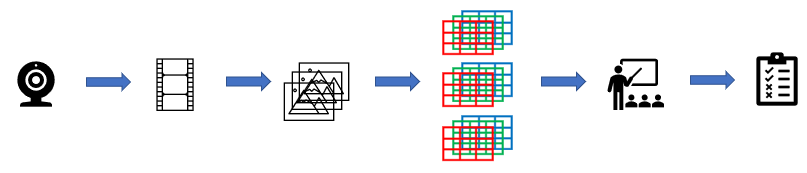

The above illustrates the general workflow for Model Development:

1) Set up a webcam to stream the product assembly.<br>
2) Retrieve a video feed from the stream.<br>
3) Save the video feed as a sequence of seperate images and classify as either `Pass` or `Fail`.<br>
4) Preprocess and transform the images into an array of matrices in RGB space.<br>
5) Feed this into a variant of a Convolutional Neural Network (CNN) model for training.<br>
6) Test the model in a Live Video Classification setting.<br>

In [2]:
#Imports

# comment out the following codes to use GPU instead of CPU for tensorflow (only applicable if tensorflow-gpu is installed)
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="-1"

# Import libraries and modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Image and Video loading imports
import cv2 as cv
from PIL import Image
import pathlib

# Neural Network libraries imports
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras import utils
from tensorflow.keras.preprocessing import image_dataset_from_directory
from sklearn.model_selection import train_test_split

# For reproducibility
np.random.seed(42)

# To keep notebook clean
import warnings
warnings.filterwarnings('ignore')

## Base Dataset

Note: Please refer to 'Webcam Video Feed and Capture.ipynb' under Section 'Image Capture from Video Feed' for the OpenCV API for image capture from a webcam video feed.

### Data Loading and Analysis

In [3]:
#Using pathlib to load the folder path to our dataset
data_dir = pathlib.Path('../img/finished_train/')
data_dir

WindowsPath('../img/finished_train')

In [4]:
#retrieving all the image files in the dataset folder
list(data_dir.glob('*/*.jpg'))[:5]

[WindowsPath('../img/finished_train/fail/fail_1000.jpg'),
 WindowsPath('../img/finished_train/fail/fail_1001.jpg'),
 WindowsPath('../img/finished_train/fail/fail_1002.jpg'),
 WindowsPath('../img/finished_train/fail/fail_1003.jpg'),
 WindowsPath('../img/finished_train/fail/fail_1004.jpg')]

In [9]:
image_count = len(list(data_dir.glob('*/*.jpg')))
image_count

14438

In [ ]:
#setting the list of paths for image files in a dict
images_dict = {
    'pass': list(data_dir.glob('pass/*.jpg')),
    'fail': list(data_dir.glob('fail/*.jpg'))
}

#setting the labels in a dict with integer values (since CNN does not )
labels_dict = {
    'pass': 1,
    'fail': 0,
}

In [24]:
img = cv.imread(str(images_dict['pass'][0]))
img.shape

(720, 1280, 3)

Total no. of images across both 'Pass' and 'Fail' class labels is 14,438. each image shape is (720, 1280, 3) which represents the resolution of the webcam (1280 x 720 pixels) and 3 colour channels in BGR format (since OpenCV saves images in BGR format initially).

The images will be resized to (320,240) to reduce memory usage and converted to RGB to preserve the actual image colours.

In [7]:
IMAGE_SHAPE = (320,240)

#setting X and y for training
X, y = [], []

for lbl, imgs in images_dict.items():
    for img in imgs:
        img = cv.imread(str(img))
        recolored_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)	#convert from BGR format to RGB format
        resized_img = cv.resize(recolored_img, IMAGE_SHAPE)
        X.append(resized_img)
        y.append(labels_dict[lbl])
        
X = np.array(X)
y = np.array(y)

#train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, test_size=0.1, stratify=y)

#normalization
X_train_sc = X_train / 255
X_test_sc = X_test / 255


Around 7000 images were taken of a finished product assembly as seen below for the `'Pass'` class label. 

'Pass' Image


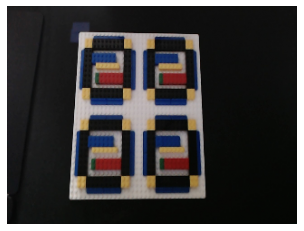

In [11]:
plt.axis('off')
print(f"\033[4m'Pass' Image\033[0m")
plt.imshow(X_train_sc[1]);

For `'Fail'`, around 7000 images were taken as well of different levels and permutations of fails. Examples are depicted below.

'Fail' Image (1x Red)


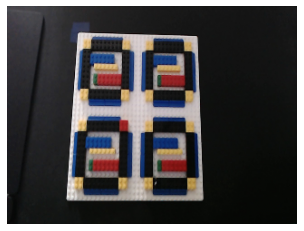

In [12]:
plt.axis('off')
print(f"\033[4m'Fail' Image (1x Red)\033[0m")
plt.imshow(X_train_sc[10000]);

'Fail' Image (Some Red)


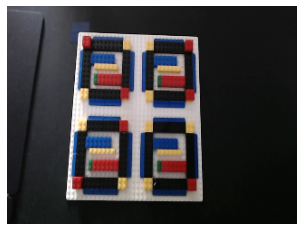

In [23]:
plt.axis('off')
print(f"\033[4m'Fail' Image (Some Red)\033[0m")
plt.imshow(X_train_sc[12001]);

'Fail' Image (All Red)


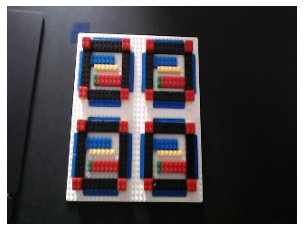

In [18]:
plt.axis('off')
print(f"\033[4m'Fail' Image (All Red)\033[0m")
plt.imshow(X_train_sc[12501]);

## Model Selection

Prior to the Model Training proper, I will first discuss on model selection. For this project, we compared between a Custom CNN vs. Transfer Learning with pre-trained model InceptionV3.


#### Custom CNN

In [7]:
#loading the validation dataset
IMAGE_SHAPE = (320,240)
data_dir_val = pathlib.Path('../img/finished_val/')
image_count = len(list(data_dir_val.glob('*/*.jpg')))
print(f'Image Count = {image_count}')

images_dict_val = {
    'pass': list(data_dir_val.glob('pass/*.jpg')),
    'fail': list(data_dir_val.glob('fail/*.jpg'))
}

labels_dict = {
    'pass': 1,
    'fail': 0,
}

X_val, y_val = [], []

for lbl, imgs in images_dict_val.items():
    for img in imgs:
        img = cv.imread(str(img))
        recolored_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)	#convert from BGR format to RGB format
        resized_img = cv.resize(recolored_img, IMAGE_SHAPE)
        X_val.append(resized_img)
        y_val.append(labels_dict[lbl])

X_val = np.array(X_val)
y_val = np.array(y_val)

X_val_sc = X_val / 255

Image Count = 10500


In [8]:
cnn_model = tf.keras.models.load_model('../model/cnn_model_finished/')

cnn_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 240, 320, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 120, 160, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 118, 158, 64)      9280      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 59, 79, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 298304)            0         
_________________________________________________________________
dense (Dense)                (None, 64)                19091520  
_________________________________________________________________
dropout (Dropout)            (None, 64)                0

In [9]:
%%time

cnn_model.evaluate(X_val_sc, y_val)

329/329 [==============================] - 36s 110ms/step - loss: 0.0011 - accuracy: 1.0000
CPU times: total: 11min 6s
Wall time: 39.4 s


[0.0010812958935275674, 1.0]

#### InceptionV3

In [11]:
#loading the validation dataset
IMAGE_SHAPE = (299,299) #required for InceptionV3
data_dir_val = pathlib.Path('../img/finished_val/')
image_count = len(list(data_dir_val.glob('*/*.jpg')))
print(f'Image Count = {image_count}')

images_dict_val = {
    'pass': list(data_dir_val.glob('pass/*.jpg')),
    'fail': list(data_dir_val.glob('fail/*.jpg'))
}

labels_dict = {
    'pass': 1,
    'fail': 0,
}

X_val, y_val = [], []

for lbl, imgs in images_dict_val.items():
    for img in imgs:
        img = cv.imread(str(img))
        recolored_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)	#convert from BGR format to RGB format
        resized_img = cv.resize(recolored_img, IMAGE_SHAPE)
        X_val.append(resized_img)
        y_val.append(labels_dict[lbl])

X_val = np.array(X_val)
y_val = np.array(y_val)

X_val_sc = X_val / 255

Image Count = 10500


In [10]:
tflearn_model = tf.keras.models.load_model('../model/cnn_model_finished_tflearn/')

tflearn_model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer_1 (KerasLayer)   (None, 2048)              21802784  
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2049      
Total params: 21,804,833
Trainable params: 2,049
Non-trainable params: 21,802,784
_________________________________________________________________


In [12]:
%%time

tflearn_model.evaluate(X_val_sc, y_val)

329/329 [==============================] - 288s 872ms/step - loss: 0.0203 - accuracy: 0.9969
CPU times: total: 1h 52min 5s
Wall time: 4min 51s


[0.020316561684012413, 0.9968571662902832]

Based on the time required to perform the evaluation validation dataset, Custom CNN will be chosen as the CNN model of choice for our project. This is because our intended implementation is a Live Video Classification and we require fast prediction times so that the prediction can keep up with the Live Video feed. 

<u>Time taken to evaluate 10,500 images</u><br>
Custom CNN (chosen): 39.4s<br>
InceptionV3: 4min 51s<br>

## Base Dataset Model

### Model Training

Note: Please refer to 'CNN Training.ipynb' under Section 'Base Dataset Model' for Model training.

### Model Testing

Please refer to link below for the video capture of the Live Video Classification Testing:
https://drive.google.com/file/d/1dmB5tS9c_A7zvH5BOcsDt4qhMfX432IF/view?usp=sharing

When the Base Dataset Model was tested in a Live Video Classification environment, several issues were present:

- Misclassification due to orientation (shown below)
- Misclassification due to hands being in the frame
- Misclassification due to glare on certain parts of the product

I then hypothesised that this is probably due to lack of variability in the 'Pass' Dataset. 

**Correct Orientation**

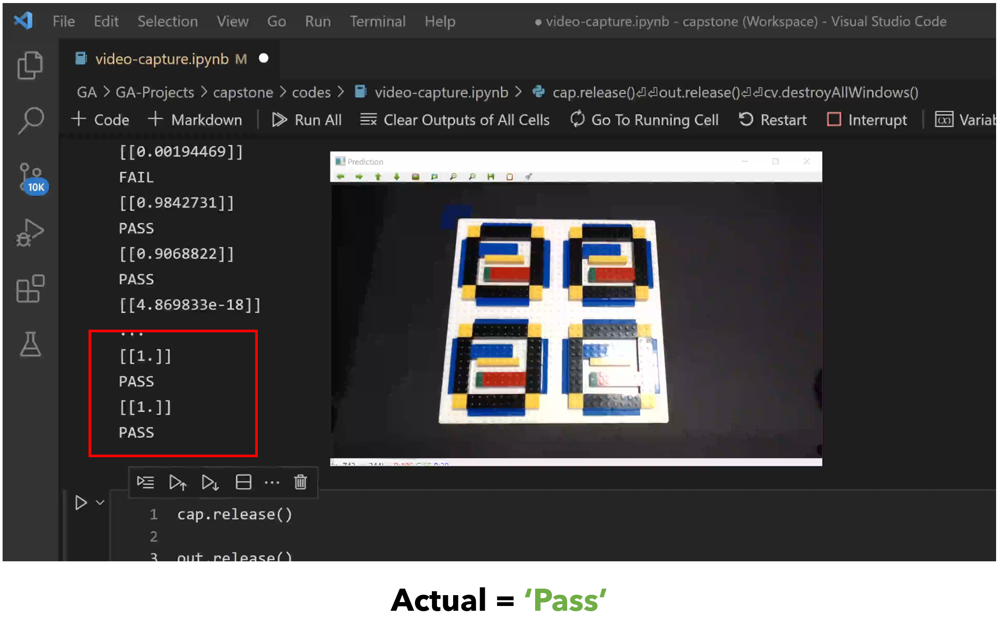

**Skewed Orientation**

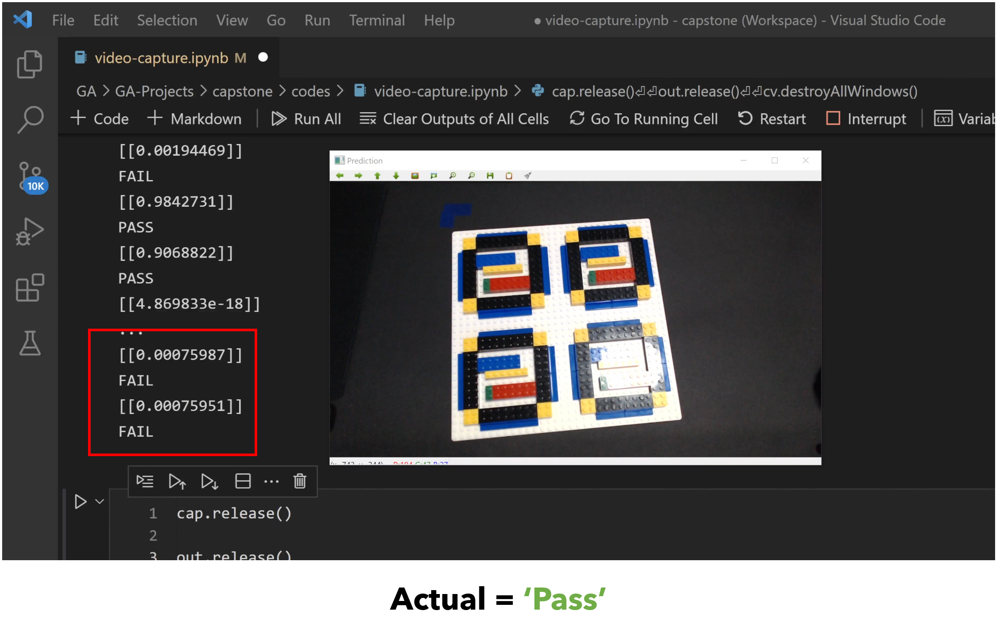

## Dataset with Variability in 'Pass' Model

### Data Acquisition and Model Retraining

An extra ~3000 images of `'Pass'` was then obtained with varying hand poses, product orientation, and lighting conditions:

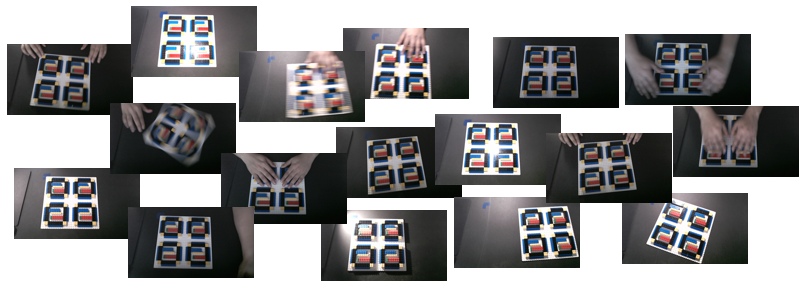

The model was then retrained with the new dataset and tested.

### Model Testing

Please refer to link below for the video capture of the Live Video Classification Testing:<br>
`'Pass'`: https://drive.google.com/file/d/1dLKO3XmV-5L8t3F9x1jXY63FZu1VHNNm/view?usp=sharing<br>
`'Fail'`: https://drive.google.com/file/d/1d_x7CE8TNfKMQrTA4FRJSSEor_ZTGifD/view?usp=sharing<br>


When the Dataset with Variability in 'Pass' Model was tested in a Live Video Classification environment, previous issues that were present before has now been fixed:

Fixed:
- Correctly classifies despite different product orientation (shown below)
- Correctly classifies even with hand presence and movement 
- Correctly classifies at current lighting condition


**Correct Orientation**


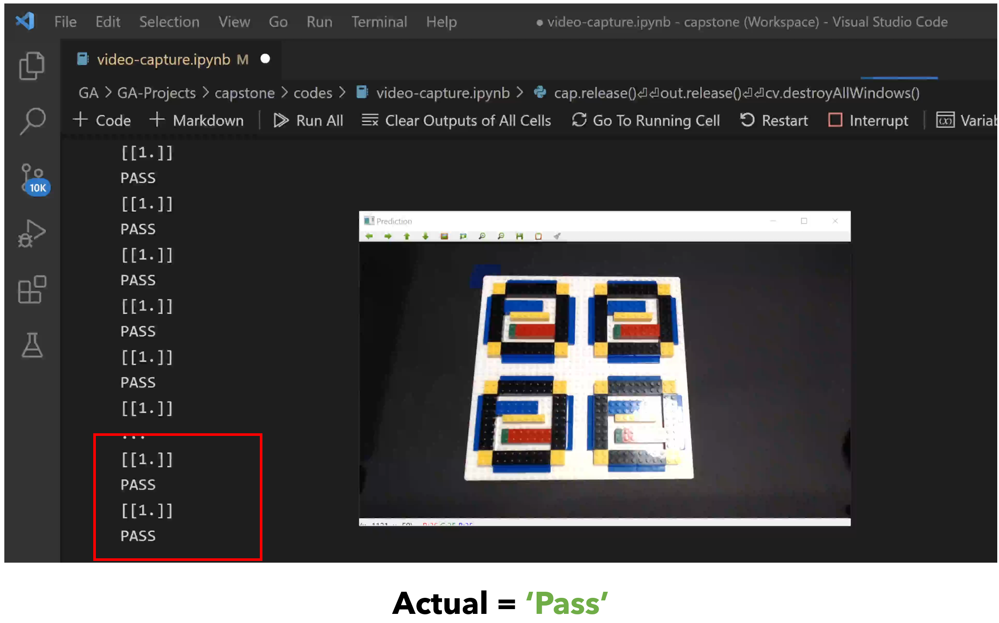

**Skewed Orientation**

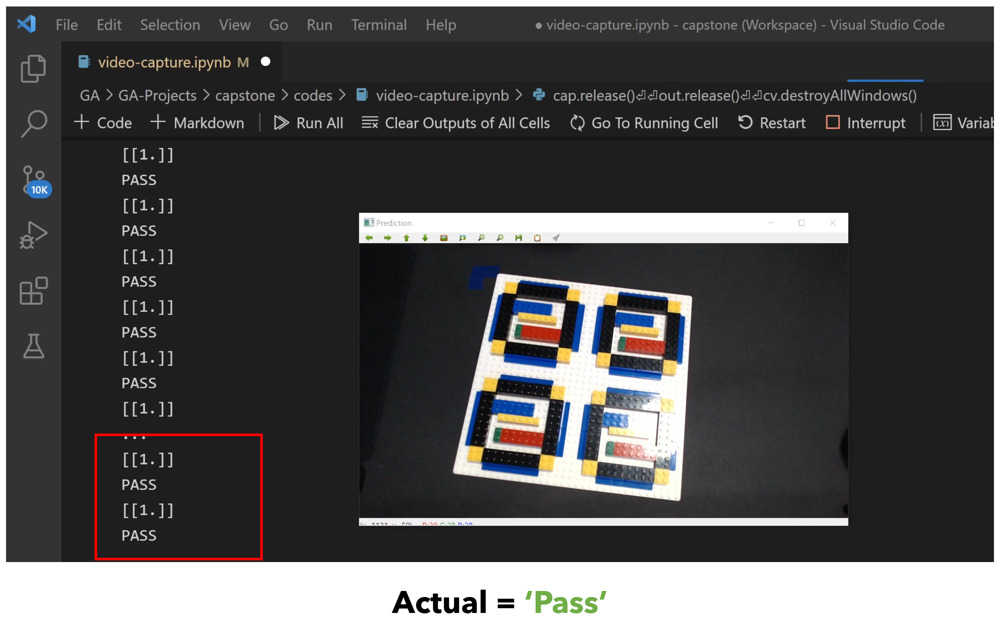

**Correct Orientation, Different Location**

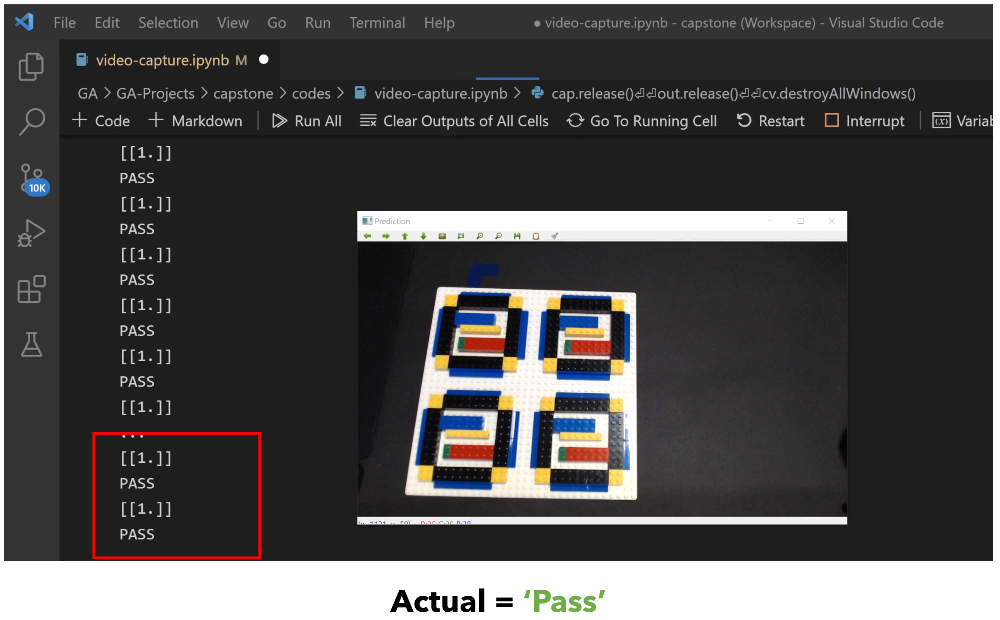

However, when testing with the `'Fail'` dataset, we encountered the following problems instead:

Issues:
- Presence of hands = ‘Pass’ (shown below)
- Not sensitive to fails
    - Needed more than half of the corner blocks to be red before able to correctly detect ‘Fail’.


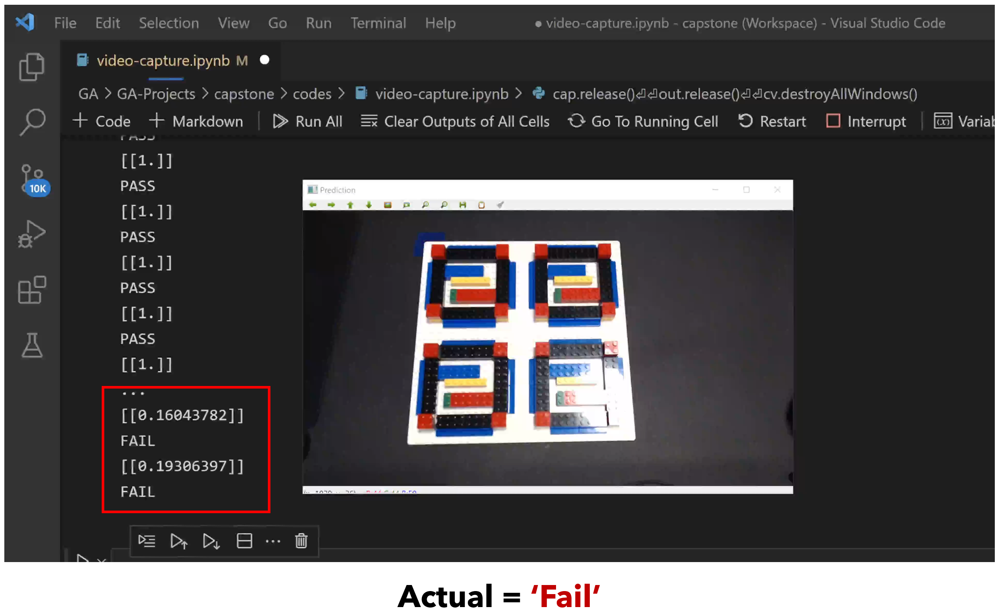

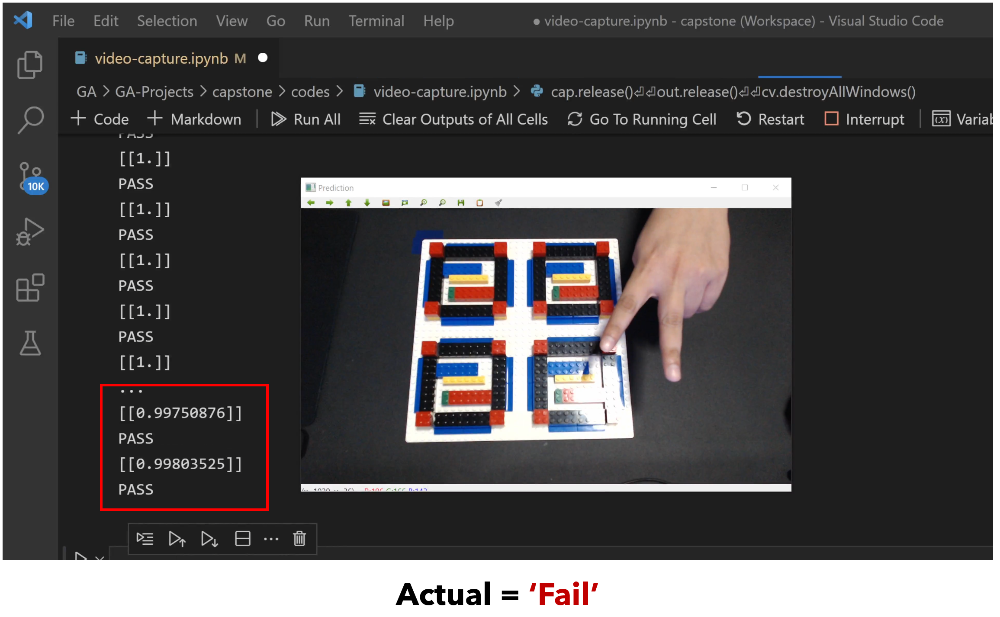

## Dataset with Variability in 'Pass' and 'Fail' Model

### Data Acquisition and Model Retraining

An extra ~3000 images of `'Fail'` was then obtained with varying hand poses, product orientation, and lighting conditions, repeating what was done in the previous section. One other thing that was done is to transfer those images with hands blocking the corner blocks over from `'Pass'` to `'Fail'`.

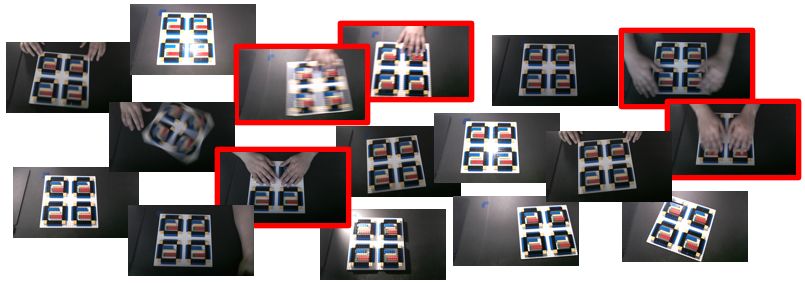

### Model Training

Note: Please refer to 'CNN Training.ipynb' under Section "Dataset with 'Pass' and 'Fail' Variability" for Model training.

### Model Testing

Please refer to link below for the video capture of the Live Video Classification Testing:
https://drive.google.com/file/d/1cVmgLXkICYzi2SQV_MBHkQYfoP251yrR/view?usp=sharing

When the Dataset with Variability in 'Pass' and 'Fail' Model was tested in a Live Video Classification environment, previous issues resurfaced:

Fixed:
- Hands blocking = ‘Fail’
    - BUT, only in certain hand poses

Issues:
- Too sensitive to orientation
- Not sensitive to fails
- Sensitive to lighting conditions


### Model Analysis

#### Feature Map

The purpose of a feature map is to help visualise the features extracted from each convolution and pooling layer from Feature Extraction.

In [ ]:
# Adapted from: https://towardsdatascience.com/convolutional-neural-network-feature-map-and-filter-visualization-f75012a5a49c

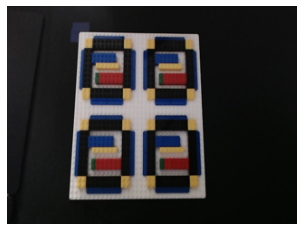

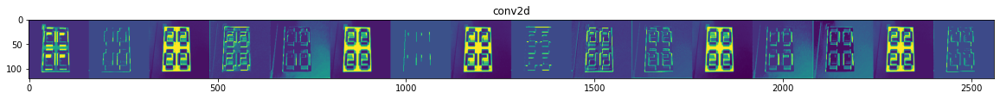

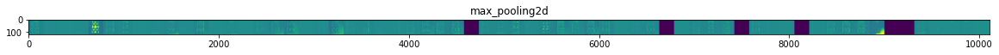

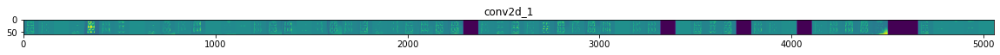

In [6]:
img_path='../img/finished_train/pass/pass_19 - Copy (10) - Copy - Copy.jpg' 

img = Image.open(str(img_path)).resize((320,240))
plt.axis('off')
plt.imshow(img)

#loading of model
model = tf.keras.models.load_model('../model/cnn_model_finished_w_variation_all')

# Let's define a new Model that will take an image as input, and will output
# intermediate representations for all layers in the previous model after
# the first.
successive_outputs = [layer.output for layer in model.layers[1:]]

#visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)

x = np.array(img)                           # Numpy array with shape (150, 150, 3)
x = np.expand_dims(x, axis=0)
# Rescale by 1/255
x = x / 255

# Let's run our image through our network, thus obtaining all
# intermediate representations for this image.
successive_feature_maps = visualization_model.predict(x)

# These are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]

# -----------------------------------------------------------------------
# Now let's display our representations
# -----------------------------------------------------------------------
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  #print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    #-------------------------------------------
    # Just do this for the conv / maxpool layers, not the fully-connected layers
    #-------------------------------------------
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size_x       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    size_y       = feature_map.shape[ 2]  # feature map shape (1, size, size, n_features)

    # We will tile our images in this matrix
    display_grid = np.zeros((size_x, size_y * n_features))
    
    #-------------------------------------------------
    # Postprocess the feature to be visually palatable
    #-------------------------------------------------
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i * size_y : (i + 1) * size_y] = x # Tile each filter into a horizontal grid

    #-----------------
    # Display the grid
    #-----------------

    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis') 

From the feature map we see the following:

- Features extracted mostly consists of the white baseplate and the other components.
- Only ~3% of the image is required but whole image is used for training and classification.



#### RGB Density Graphs

In [ ]:
# Adapted from: https://towardsdatascience.com/convolutional-neural-network-feature-map-and-filter-visualization-f75012a5a49c

In [10]:
def color_density_full(img_path):
    img = cv.imread(str(img_path))
    recolored_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)	#convert from BGR format to RGB format

    plt.imshow(recolored_img)

    dims = np.shape(recolored_img)
    pixel_matrix = np.reshape(recolored_img, (dims[0] * dims[1], dims[2]))


    plt.figure(figsize=(10,10))
    sns.distplot(pixel_matrix[:,0], bins=12, color = 'red')
    sns.distplot(pixel_matrix[:,1], bins=12, color = 'green')
    sns.distplot(pixel_matrix[:,2], bins=12, color = 'blue')
    plt.xlabel('Intensity')
    plt.xlim([0, 255])
    plt.ylim([0, 0.030])

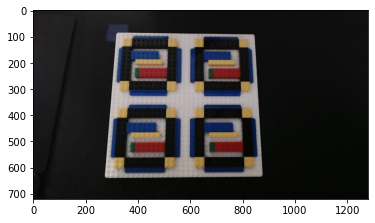

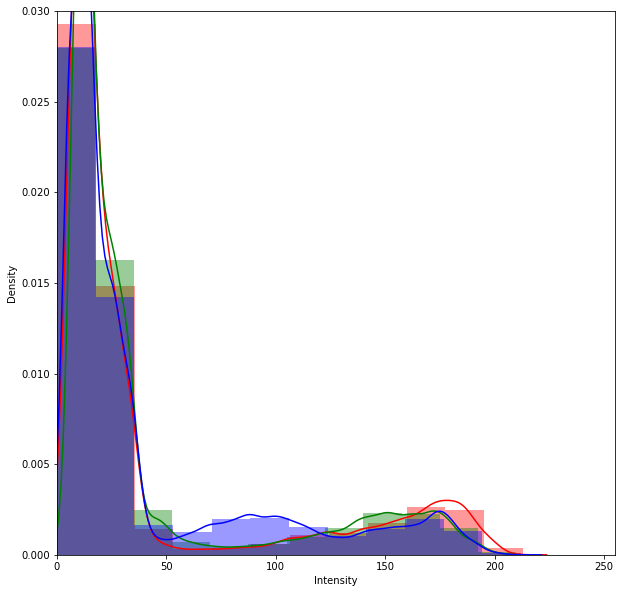

In [11]:
color_density_full('../img/finished_train/pass/pass_19 - Copy (10) - Copy - Copy.jpg')

From the RGB Density graphs we see the following:

- Blacks are more pronounced (higher density peaks) as it takes up more than 50% of the image.
- Differences between classes are not as pronounced as they are of lower density. 


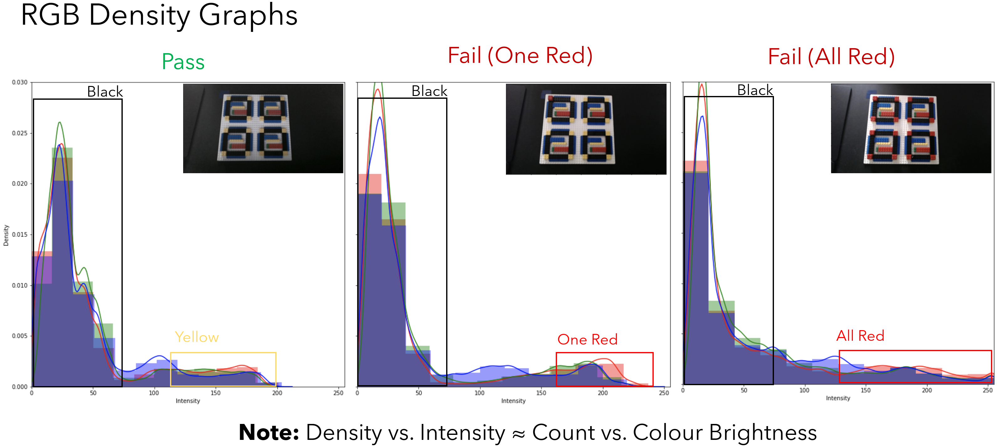

## Dataset with Implementation of Regions of Interest (ROIs)

From the previous models we see that the model is not extracting relevant and critical features required for analysis and predicting between `'Pass'` and `'Fail'`.

Thus, next, I will be implenting regions of interest (ROI) in hopes of improving the model performance. In configuring ROIs, the image is reduced only to the area relevant for analysis.

Benefits:

- Reduces the image size
- Reduce memory required to evaluate each image 
- Faster predictions
- Reduce noise/variability picked up from non-critical areas.

Model Implementation:

- Set fixed coordinates on the capture video for our model to analyse, given a fixed orientation of the product on the workstation. 


### Required Setup

A change in setup is required in order to achieve this. As mentioned, we need to fix the orientation and location of the product on the workstation. As such, a blue square demarcation is added onto the workstation and the Production Operators will be instructed to place the white baseplate within the demarcation

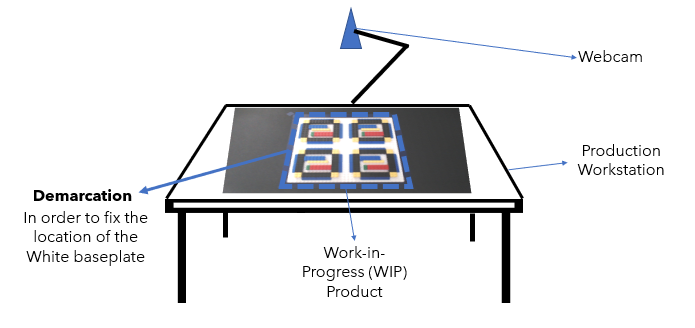

### Data Loading and Preprocessing

#### General Overview


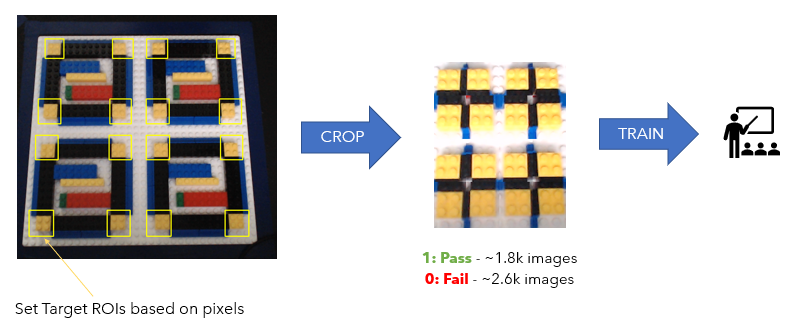

#### Example

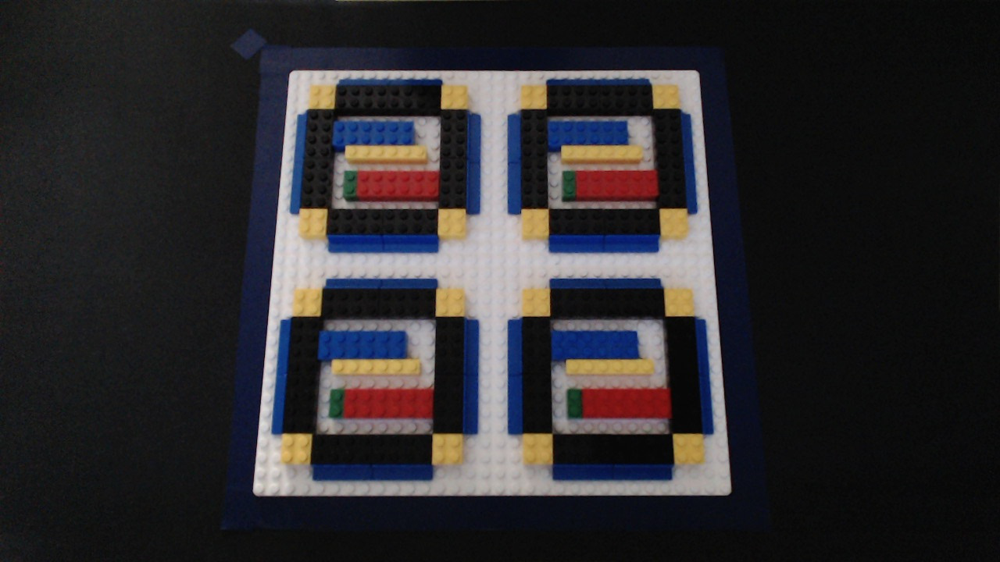

In [4]:
pass1 = Image.open('../img/crop/pass/passimage_c_1.jpg')
pass1


In [5]:
pass1 = np.array(pass1)/255
print(pass1[np.newaxis, ...].shape)

(1, 720, 1280, 3)


In [6]:
cropped_1strow = np.concatenate((pass1[101:152, 385:435], pass1[101:152, 561:611], pass1[101:152, 655:705], pass1[101:152, 831:881]), axis = 1)
cropped_2ndrow = np.concatenate((pass1[258:323, 375:425], pass1[258:323, 555:605], pass1[258:323, 660:710], pass1[258:323, 838:888]), axis = 1)
cropped_3rdrow = np.concatenate((pass1[353:417, 370:420], pass1[353:417, 550:600], pass1[353:417, 664:714], pass1[353:417, 845:895]), axis = 1)
cropped_4throw = np.concatenate((pass1[549:619, 356:406], pass1[549:619, 550:600], pass1[549:619, 664:714], pass1[549:619, 856:906]), axis = 1)

cropped = np.concatenate((cropped_1strow, cropped_2ndrow, cropped_3rdrow, cropped_4throw), axis = 0)

(250, 200, 3)


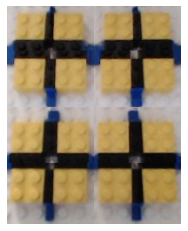

In [7]:
print(cropped.shape)
plt.axis('off')
plt.imshow(cropped);

### Model Training


Note: Please refer to 'CNN Training.ipynb' under Section 'ROI Dataset Model' for Model training.

### Model Testing

Please refer to link below for the video capture of the Live Video Classification Testing:<br>
https://drive.google.com/file/d/1dENAEKTvDgw5BtlTc3ZxSVMkpVM-KxKR/view?usp=sharing

When the ROI Model was tested in a Live Video Classification environment, a more accurate performance was achieved.

Fixed:
- Easy to obtain accurate predictions.
    - Model will work so long as all the corner blocks are within ROIs.
- Sensitive to fails
    - 1 red block = ‘Fail’. (shown below)
    


**One Red Block Testing**

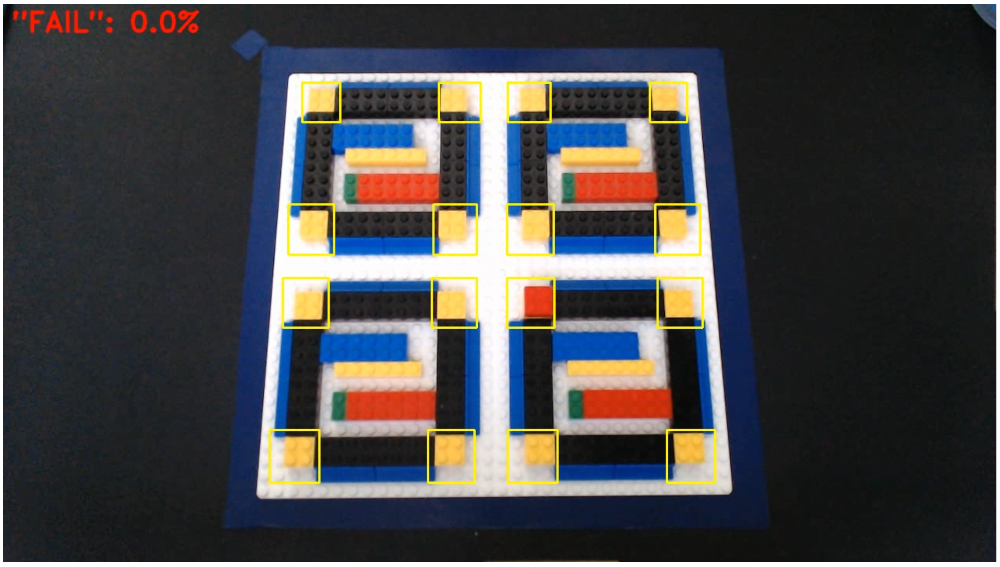

### Model Analysis

#### Feature Map

The purpose of a feature map is to help visualise the features extracted from each convolution and pooling layer from Feature Extraction.

In [3]:
# Adapted from: https://towardsdatascience.com/convolutional-neural-network-feature-map-and-filter-visualization-f75012a5a49c

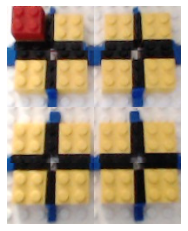

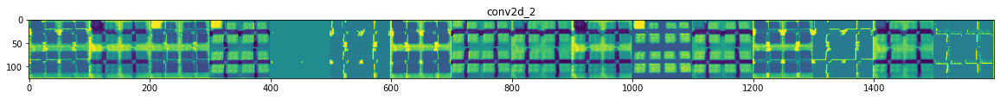

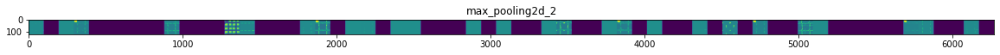

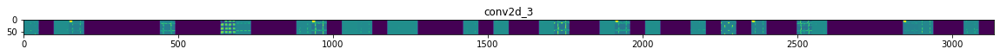

In [16]:
img_path='../img/crop/fail/failimage_c_1.jpg' 


img = cv.imread(str(img_path))
recolored_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)	#convert from BGR format to RGB format

#extracting the corner blocks
cropped_1strow = np.concatenate((recolored_img[101:152, 385:435], recolored_img[101:152, 561:611], recolored_img[101:152, 655:705], recolored_img[101:152, 831:881]), axis = 1)
cropped_2ndrow = np.concatenate((recolored_img[258:323, 375:425], recolored_img[258:323, 555:605], recolored_img[258:323, 660:710], recolored_img[258:323, 838:888]), axis = 1)
cropped_3rdrow = np.concatenate((recolored_img[353:417, 370:420], recolored_img[353:417, 550:600], recolored_img[353:417, 664:714], recolored_img[353:417, 845:895]), axis = 1)
cropped_4throw = np.concatenate((recolored_img[549:619, 356:406], recolored_img[549:619, 550:600], recolored_img[549:619, 664:714], recolored_img[549:619, 856:906]), axis = 1)

cropped = np.concatenate((cropped_1strow, cropped_2ndrow, cropped_3rdrow, cropped_4throw), axis = 0)
plt.axis('off')
plt.imshow(cropped)

#loading of model
model = tf.keras.models.load_model('../model/cnn_model_finished_cropped/')

# Let's define a new Model that will take an image as input, and will output
# intermediate representations for all layers in the previous model after
# the first.
successive_outputs = [layer.output for layer in model.layers[1:]]

#visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)

x = np.array(cropped)                           # Numpy array with shape (150, 150, 3)
x = np.expand_dims(x, axis=0)
# Rescale by 1/255
x = x / 255

# Let's run our image through our network, thus obtaining all
# intermediate representations for this image.
successive_feature_maps = visualization_model.predict(x)

# These are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]

# -----------------------------------------------------------------------
# Now let's display our representations
# -----------------------------------------------------------------------
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  #print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    #-------------------------------------------
    # Just do this for the conv / maxpool layers, not the fully-connected layers
    #-------------------------------------------
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size_x       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    size_y       = feature_map.shape[ 2]  # feature map shape (1, size, size, n_features)

    # We will tile our images in this matrix
    display_grid = np.zeros((size_x, size_y * n_features))
    
    #-------------------------------------------------
    # Postprocess the feature to be visually palatable
    #-------------------------------------------------
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i * size_y : (i + 1) * size_y] = x # Tile each filter into a horizontal grid

    #-----------------
    # Display the grid
    #-----------------

    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis') 

From the feature map we see the following:

- Relevant features are extracted.
- A higher percentage (~50%) of the image is used for classification.



#### RGB Density Graphs

In [9]:
# Adapted from: https://towardsdatascience.com/convolutional-neural-network-feature-map-and-filter-visualization-f75012a5a49c

In [10]:
def color_density_cropped(img_path):
    img = cv.imread(str(img_path))
    recolored_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)	#convert from BGR format to RGB format

    #extracting the corner blocks
    cropped_1strow = np.concatenate((recolored_img[101:152, 385:435], recolored_img[101:152, 561:611], recolored_img[101:152, 655:705], recolored_img[101:152, 831:881]), axis = 1)
    cropped_2ndrow = np.concatenate((recolored_img[258:323, 375:425], recolored_img[258:323, 555:605], recolored_img[258:323, 660:710], recolored_img[258:323, 838:888]), axis = 1)
    cropped_3rdrow = np.concatenate((recolored_img[353:417, 370:420], recolored_img[353:417, 550:600], recolored_img[353:417, 664:714], recolored_img[353:417, 845:895]), axis = 1)
    cropped_4throw = np.concatenate((recolored_img[549:619, 356:406], recolored_img[549:619, 550:600], recolored_img[549:619, 664:714], recolored_img[549:619, 856:906]), axis = 1)

    cropped = np.concatenate((cropped_1strow, cropped_2ndrow, cropped_3rdrow, cropped_4throw), axis = 0)
    plt.imshow(cropped)

    dims = np.shape(cropped)
    pixel_matrix = np.reshape(cropped, (dims[0] * dims[1], dims[2]))


    plt.figure(figsize=(10,10))
    sns.distplot(pixel_matrix[:,0], bins=12, color = 'red')
    sns.distplot(pixel_matrix[:,1], bins=12, color = 'green')
    sns.distplot(pixel_matrix[:,2], bins=12, color = 'blue')
    plt.xlabel('Intensity')
    plt.xlim([0, 255])
    plt.ylim([0, 0.025])


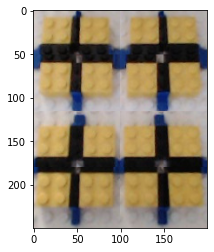

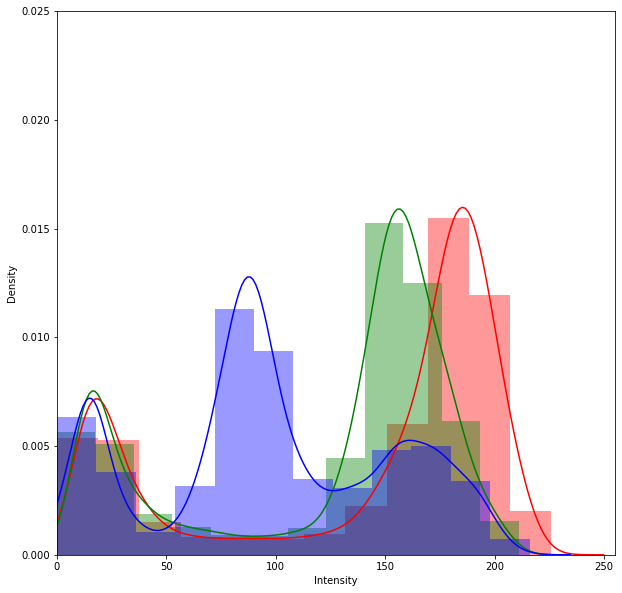

In [13]:
color_density_cropped('../img/crop/pass/passimage_c_1.jpg')

From the RGB Density graphs we see the following:

- Previous blacks are less pronounced (lower density).
- Model is now able to pick out corner block colours better.
    - E.g. when One Red is introduced, the red hue graph peak increases in intensity and has a larger area under the graph (higher overall density).



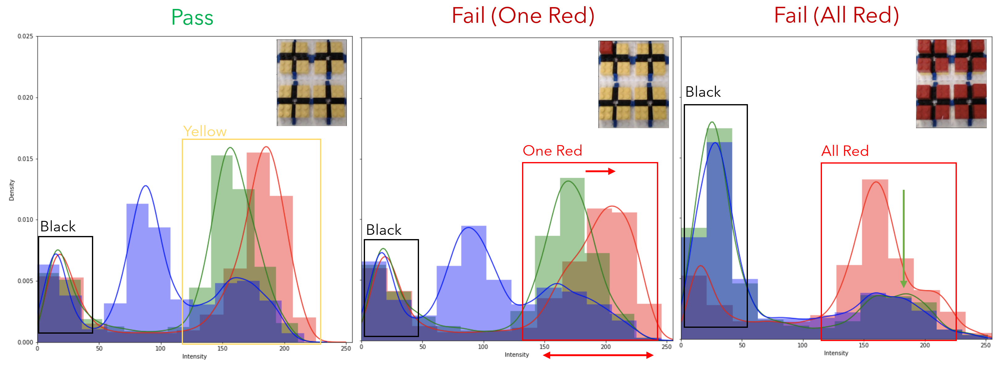

# Production Model Implementation

## Recommended Setup

### Workstation

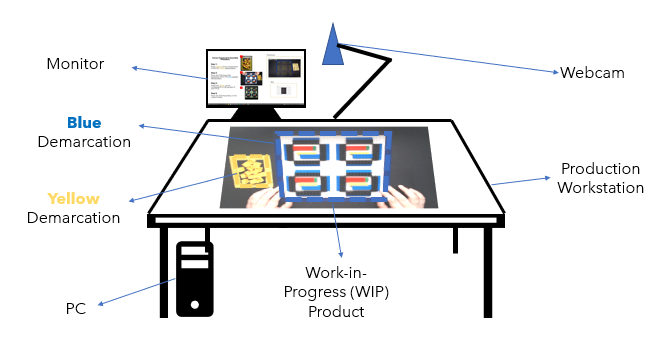

The recommended setup for model implementation will be similar to the ROI model setup except for a few additions:

1) Yellow Demarcation for Yellow blocks <br>
2) Monitor to output the model prediction <br>
3) PC to run the model<br>


### Monitor

The monitor installed at the workstation will be showing 1) a short guideline on the proper Corner Component Assembly Procedure and 2) Live Video Prediction of the ongoing assembly process so that the operator can actually have a feedback loop on the product quality.

Note: Please refer to 'Webcam Video Feed and Capture.ipynb' under Sections "Initialization of Webcam", "Setting Webcam Streaming/Capture Specifications", and "Production Model Live Video Classification (ROI Dataset/Multiclass)".

Screen Capture of Ongoing Assembly Live Video Classification:<br>
https://drive.google.com/file/d/1dDS_45bm24q8aYMPldSqLOKJiNfSgnXb/view?usp=sharing

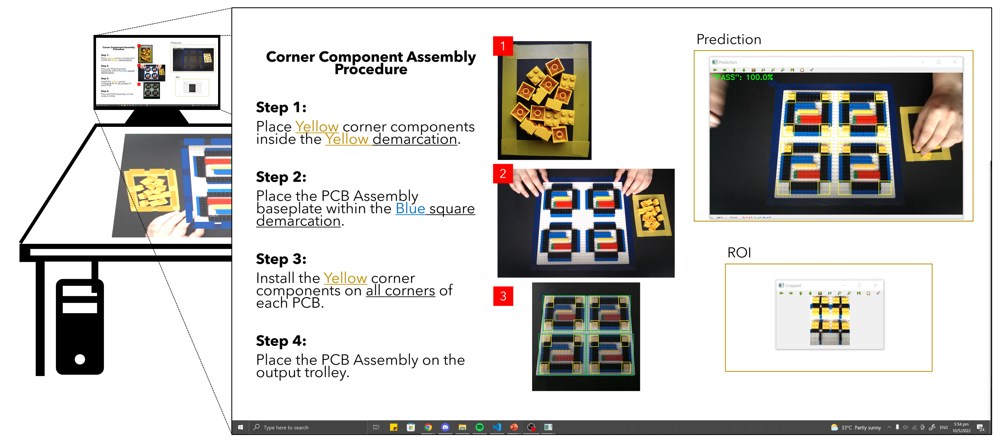

### Implementation Workflow

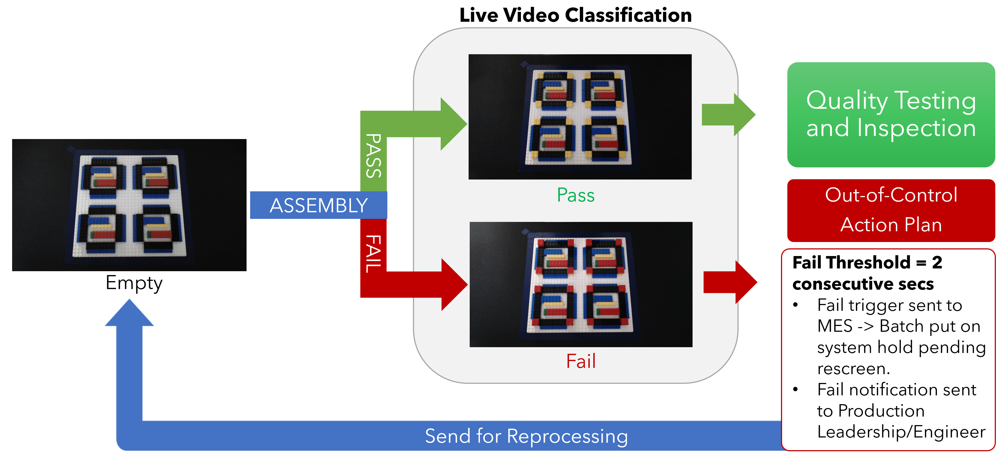

The expected workflow will be as per the illustration above. The model will be running throughout the assembly process and if there aren't any `'Fail'` predictions, the batch will proceed to the next steps as per normal. However, if there is a persistent `'Fail'` trigger for consecutive 2 seconds, an Out-of-Control Plan will kick in whereby 1) Fail trigger will be sent to Manufacturing Execution System (MES) and the batch will be put on system hold pending rescreen, 2) Fail notification sent to Production Leadership/Engineer to inform them on this for further actions.

Note: Implementation and interactions with Manufacturing Execution System (MES) are not shown in this project.

# Conclusion

## Model Evaluation

Current model is highly accurate and is sensitive to ‘Fail’. This is sufficient to deploy to production to fix the current problem.

However, there are some downsides with the current model and its implementation:

1) Requires strict human adherence to procedure. <br>
    i.e. Putting the white baseplate exactly within the blue box, aligning corner components to ROI.

<u>Proposed Future Improvement</u>
    
- This can be improved on by increasing the pixels for each ROI, allowing for some flexibility in terms of baseplate orientation.
- Implement object detection that can capture the baseplate in a bounding box and subsequently, determine ROI based on the orientation of the baseplate.



2) Predictions flickers quickly from ‘Pass’ to ‘Fail’ in certain instances. <br>
i.e. When blocking multiple ROIs with hands during product assembly.
	
<u>Proposed Future Improvement</u>

- Deploy a Convolutional Neural Network (CNN) and a Recurrent Neural Network (RNN), also know as CRNN, model that takes into account the predictions of the previous few frames before predicting current frame
    - ‘Fails’ will be predicted only if it has happened over several frames instead of instantaneous.



## Future Works



- Model can be pushed to the next level by implementing another class, “Ongoing”, to represent unfinished product assembly. This would mean that the model is able to detect missing/uninstalled corner yellow blocks. 

- The images for the other components can also be fed to another model with a different ROI to detect defects from upstream processes. This means that we can detect nonconformance from upstream processes using the same video frame.

- Implement object detection to detect foreign materials (red blocks in this case) within the workstation, thus, further reducing the risk of wrong assembly.
